In [2]:
import captum
import pandas as pd
import matplotlib.pyplot as plt
import torch
import copy

from matplotlib.patches import Rectangle
from os import path
from skimage import io
from torch import optim
from torch.nn import Linear, CrossEntropyLoss
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import models

In [3]:
labels_frame = pd.read_csv(path.join('..', '..', 'input', 'inz-data-prep', 'easy_labels_and_data.csv'), index_col=0)

In [4]:
def show_image_bbox(image, bboxes: pd.DataFrame):
    plt.imshow(image)
    ax = plt.gca()
    for idx, bbox in bboxes.iterrows():
        x = (bbox[0] - bbox[2] / 2) * 512
        y = (bbox[1] - bbox[3] / 2) * 512

        rect = Rectangle((x, y), bbox[2] * 512, bbox[3] * 512, fill=False, edgecolor='r')
        ax.add_patch(rect)
        
        
class CropWeedDataset(Dataset):
    
    def __init__(self, labels_csv, images_dir, transform=None):
        self.labels_frame = pd.read_csv(labels_csv, index_col=0)
        self.grouped_labels_frame = self.labels_frame.groupby('filename').sum("label")
        self.images_dir = images_dir
        self.transform = transform
        
    def __len__(self):
        return len(self.grouped_labels_frame)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        img_name = path.join(self.images_dir,
                                self.get_filename(idx))
        image = io.imread(img_name)
        label = int(self.grouped_labels_frame.iloc[idx, 0] > 0)
        
        sample = {'image': image, 'label': label}

        if self.transform:
            sample = self.transform(sample)

        return sample
    
    def get_bbox(self, idx):
        bbox = self.labels_frame.loc[self.labels_frame['filename'] == self.grouped_labels_frame.iloc[idx].name].iloc[:,2:6]
        return bbox
    
    def get_filename(self, idx):
        return self.grouped_labels_frame.iloc[idx].name
    
    def show_image(self, idx):
        sample = self[idx]
        bbox = self.get_bbox(idx)

        if self.transform:
            numpy_image = sample['image'].numpy().transpose(1, 2, 0)
        else:
            numpy_image = sample['image']

        show_image_bbox(numpy_image, bbox)


    
class ToTensor(object):
    """Convert ndarrays in sample to Tensors."""

    def __call__(self, sample):
        image, label = sample['image'], sample['label']

        # swap color axis because
        # numpy image: H x W x C
        # torch image: C x H x W
        image = image.transpose((2, 0, 1))
        return {'image': torch.from_numpy(image) / 255,
                'label': torch.asarray(label)}

In [5]:
dataset = CropWeedDataset(labels_csv=path.join('..', '..', 'input', 'inz-data-prep', 'easy_labels_and_data.csv'),
                          images_dir=path.join('..', '..', 'input','crop-and-weed-detection-data-with-bounding-boxes','agri_data', 'data'),
                          transform=ToTensor())

In [6]:
train, test = random_split(dataset, [950, 204], generator=torch.Generator().manual_seed(420))
dataloaders = {'train':DataLoader(train, batch_size=8, shuffle=True, num_workers=2), 
               'val': DataLoader(test, batch_size=8, shuffle=True, num_workers=2)}
dataset_sizes = {'train': 950,
                'val': 204}


## Load model

In [7]:
import torch.nn as nn
import torch.nn.functional as F


class Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 2, 5)
        self.pool1 = nn.MaxPool2d(4)
        self.conv2 = nn.Conv2d(2, 2, 4)
        self.pool2 = nn.MaxPool2d(4)
        self.fc1 = nn.Linear(2 * 31 * 31, 8)
        self.dropout = nn.Dropout(p=0.5)
        self.fc2 = nn.Linear(8, 2)

    def forward(self, x):
        x = self.pool1(self.dropout(F.relu(self.conv1(x))))
        x = self.pool2(F.relu(self.conv2(x)))
        x = self.dropout(torch.flatten(x, 1)) # flatten all dimensions except batch
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x


model = Net()

In [8]:
from torchvision.models import mnasnet0_5

# Using pretrained weights:

model = mnasnet0_5(pretrained=True)
model.classifier[1] = nn.Linear(1280, 2)
# Apply it to the input image
# img_transformed = preprocess(img)

/home/sawcio/Studia/praca inż/thesis_venv/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/home/sawcio/Studia/praca inż/thesis_venv/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=MNASNet0_5_Weights.IMAGENET1K_V1`. You can also use `weights=MNASNet0_5_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [9]:
model.load_state_dict(torch.load(path.join('..', 'models', 'mnasnet0_5'), map_location=torch.device('cpu')))
model.eval()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

In [10]:
model(torch.unsqueeze(dataset[0]['image'], 0))

tensor([[-0.3937,  0.3579]], grad_fn=<AddmmBackward0>)

In [11]:
def baseline_func(input):
    return input * 0

from torchvision import transforms
normalize = transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))

## Explanations

In [12]:
explanations_dir = path.join('..', '..', 'input', 'crop-and-weed-explanations')
ig = torch.load(path.join(explanations_dir, 'ig.pt'), map_location=torch.device('cpu'))
gs = torch.load(path.join(explanations_dir, 'gs.pt'), map_location=torch.device('cpu'))
sal = torch.load(path.join(explanations_dir, 'sal.pt'), map_location=torch.device('cpu'))

In [13]:
explanations = torch.stack([ig, gs, sal], dim=1)

In [14]:
explanations.shape

torch.Size([64, 3, 3, 512, 512])

## Aggregation

In [15]:
import sys
 
# setting path
sys.path.append('..')
 
# importing
from EnsembleXAI.Metrics import consistency, stability
from EnsembleXAI.Ensemble import ensemble, aggregate, ensembleXAI
from captum.attr import visualization

In [16]:
if False:
    agg = aggregate(explanations, 'avg')
    torch.save(agg, path.join(explanations_dir, 'avg.pt'))
else:
    agg = torch.load(path.join(explanations_dir, 'avg.pt'), map_location=torch.device('cpu'))

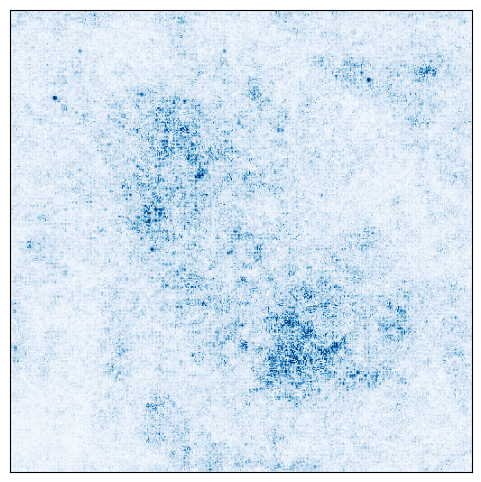

(<Figure size 600x600 with 1 Axes>, <AxesSubplot: >)

In [17]:
aggregated_sample = agg[0]
visualization.visualize_image_attr(aggregated_sample.squeeze().cpu().numpy().transpose([1,2,0]))

In [18]:
bboxes = torch.load(path.join(explanations_dir, 'bboxes.list'))
filenames = torch.load(path.join(explanations_dir, 'filenames.list'))

In [19]:
def to_numpy(tensor):
    return tensor.squeeze().cpu().numpy().transpose([1,2,0])

In [20]:
def bbox_to_mask(df, size=(512,512)):
    x_left = int(size[0] * (df.iloc[0]['x_cen'] - 0.5 * df.iloc[0]['w']))
    x_right = int(size[0] * (df.iloc[0]['x_cen'] + 0.5 * df.iloc[0]['w']))
    y_left = int(size[1] * (df.iloc[0]['y_cen'] - 0.5 * df.iloc[0]['h']))
    y_right = int(size[1] * (df.iloc[0]['y_cen'] + 0.5 * df.iloc[0]['h']))
    
    mask = torch.zeros(size)
    mask[y_left:y_right, x_left:x_right] = 1
    return mask

In [21]:
masks = []
for i in range(64):
    masks += [bbox_to_mask(bboxes[i])]
    
masks = torch.stack(masks)

In [23]:
krr_exp = ensembleXAI(explanations, masks)

In [34]:
def show_explanations(idx, image_dir=path.join('..', '..', 'input', 
                      'crop-and-weed-detection-data-with-bounding-boxes' , 
                      'agri_data', 'data')):
    image = io.imread(path.join(image_dir, filenames[idx]))
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(16, 6))
    fig, ax1 = visualization.visualize_image_attr(to_numpy(ig[idx]),
                                       original_image=image,
                                       plt_fig_axis=(fig, ax1),
                                       method='blended_heat_map',
                                       use_pyplot=False,
                                       title='integrated gradients')
    fig, ax2 = visualization.visualize_image_attr(to_numpy(gs[idx]),
                                       original_image=image,
                                       plt_fig_axis=(fig, ax2),
                                       method='blended_heat_map',
                                       use_pyplot=False,
                                       title='gradinet shap')

    visualization.visualize_image_attr(to_numpy(sal[idx]),
                                       original_image=image,
                                       plt_fig_axis=(fig, ax3),
                                       method='blended_heat_map',
                                       use_pyplot=False,
                                       title='saliency')

    visualization.visualize_image_attr(to_numpy(agg[idx]),
                                       original_image=image,
                                       plt_fig_axis=(fig, ax4),
                                       method='blended_heat_map',
                                       use_pyplot=False,
                                       title='avg aggregate')

    visualization.visualize_image_attr(to_numpy(krr_exp[idx]),
                                       original_image=image,
                                       plt_fig_axis=(fig, ax5),
                                       method='blended_heat_map',
                                       use_pyplot=False,
                                       title='krr ensembleXAI')


/tmp/ipykernel_19002/2448970813.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(16, 6))


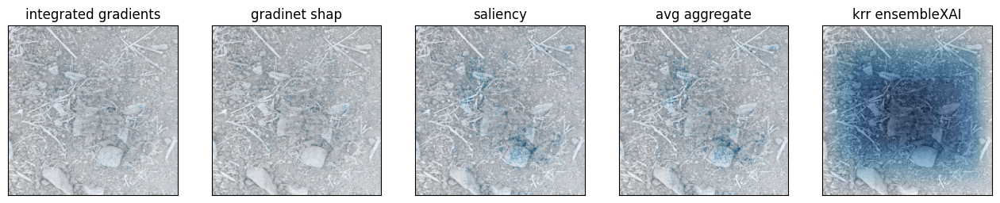

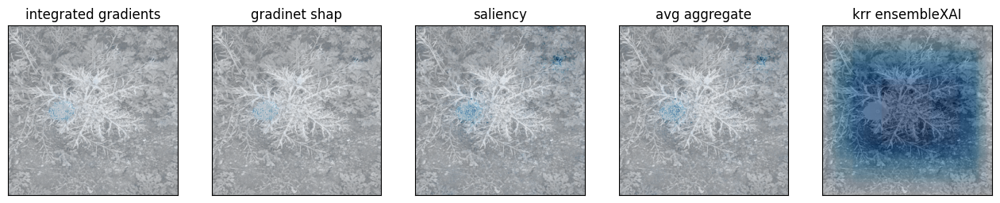

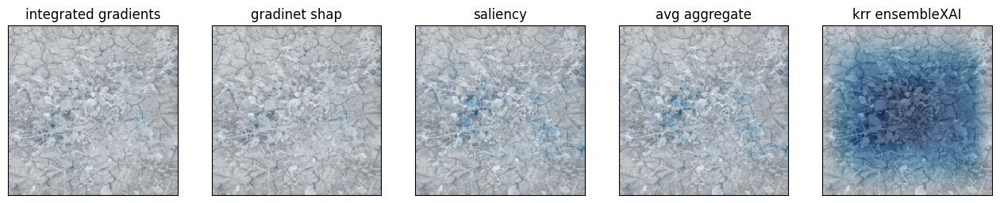

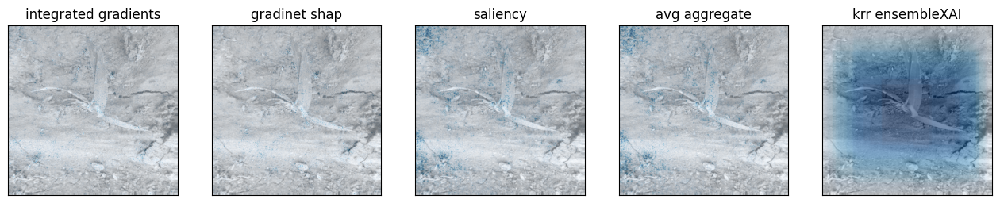

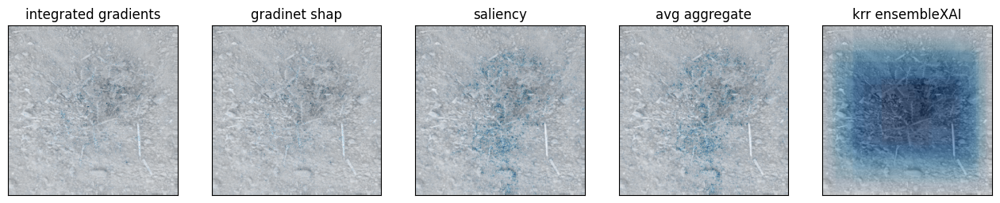

...

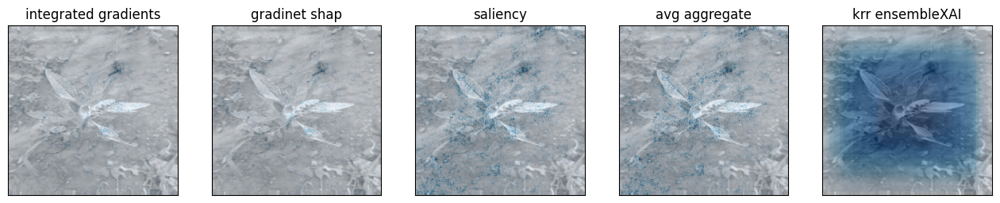

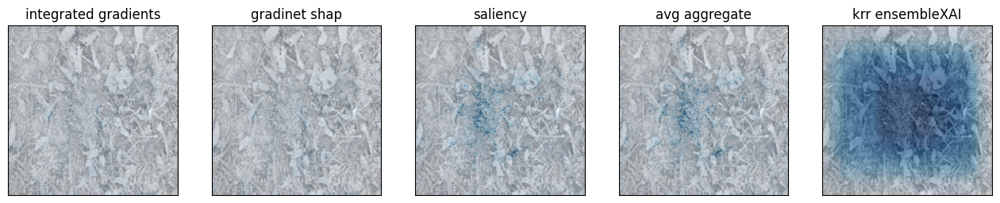

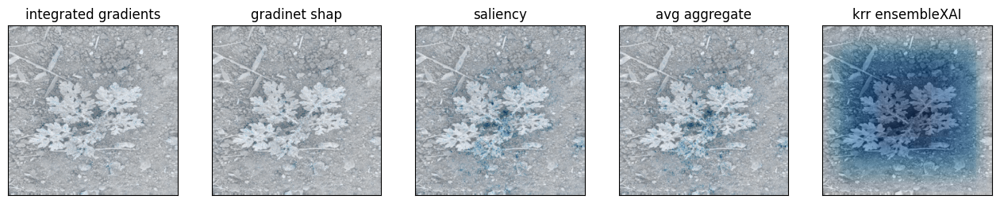

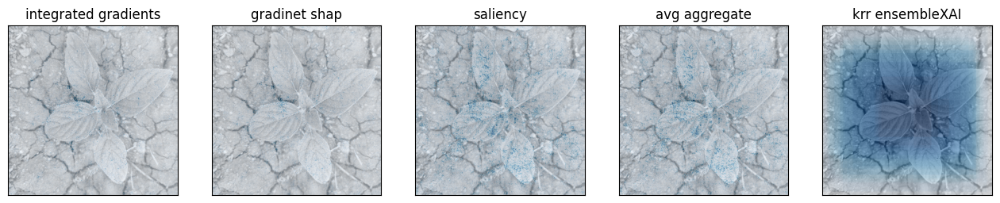

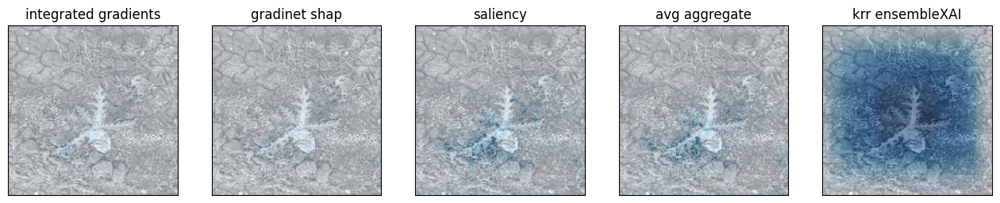

In [36]:
for i in range(64):
    show_explanations(i)